# Adding Object Detections to a Dataset

This recipe provides a glimpse into the possibilities for integrating FiftyOne into your ML workflows. Specifically, it covers:

- Loading an object detection dataset from the [Dataset Zoo](https://voxel51.com/docs/fiftyone/user_guide/dataset_zoo/index.html)
- [Adding predictions](https://voxel51.com/docs/fiftyone/user_guide/using_datasets.html#object-detection) from an object detector to the dataset
- Launching the [FiftyOne App](https://voxel51.com/docs/fiftyone/user_guide/app.html) and visualizing/exploring your data
- Integrating the App into your data analysis workflow

## Setup

If you haven't already, install FiftyOne:

In [ ]:
!pip install fiftyone

In this tutorial, we'll use an off-the-shelf [Faster R-CNN detection model](https://pytorch.org/docs/stable/torchvision/models.html#faster-r-cnn) provided by PyTorch. To use it, you'll need to install `torch` and `torchvision`, if necessary.

In [ ]:
!pip install torch torchvision

## Loading a detection dataset

In this recipe, we'll work with the validation split of the [COCO dataset](https://cocodataset.org/#home), which is conveniently available for download via the [FiftyOne Dataset Zoo](https://voxel51.com/docs/fiftyone/user_guide/dataset_zoo/datasets.html#coco-2017).

The snippet below will download the validation split and load it into FiftyOne.

In [2]:
import fiftyone as fo
import fiftyone.zoo as foz

dataset = foz.load_zoo_dataset(
    "coco-2017",
    split="validation",
    dataset_name="detector-recipe",
)

Split 'validation' already downloaded
Loading 'coco-2017' split 'validation'
 100% |████████████████████| 5000/5000 [43.3s elapsed, 0s remaining, 114.9 samples/s]      
Dataset 'detector-recipe' created


Let's inspect the dataset to see what we downloaded:

In [3]:
# Print some information about the dataset
print(dataset)

Name:           detector-recipe
Media type:     image
Num samples:    5000
Persistent:     False
Info:           {'classes': ['0', 'person', 'bicycle', ...]}
Tags:           ['validation']
Sample fields:
    filepath:     fiftyone.core.fields.StringField
    tags:         fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.Metadata)
    ground_truth: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)


In [4]:
# Print a ground truth detection
sample = dataset.first()
print(sample.ground_truth.detections[0])

<Detection: {
    'id': '602fea44db78a9b44e6ae129',
    'attributes': BaseDict({}),
    'label': 'potted plant',
    'bounding_box': BaseList([
        0.37028125,
        0.3345305164319249,
        0.038593749999999996,
        0.16314553990610328,
    ]),
    'mask': None,
    'confidence': None,
    'index': None,
    'area': 531.8071000000001,
    'iscrowd': 0.0,
}>


Note that the ground truth detections are stored in the `ground_truth` field of the samples.

Before we go further, let's launch the [FiftyOne App](https://voxel51.com/docs/fiftyone/user_guide/app.html) and use the GUI to explore the dataset visually:


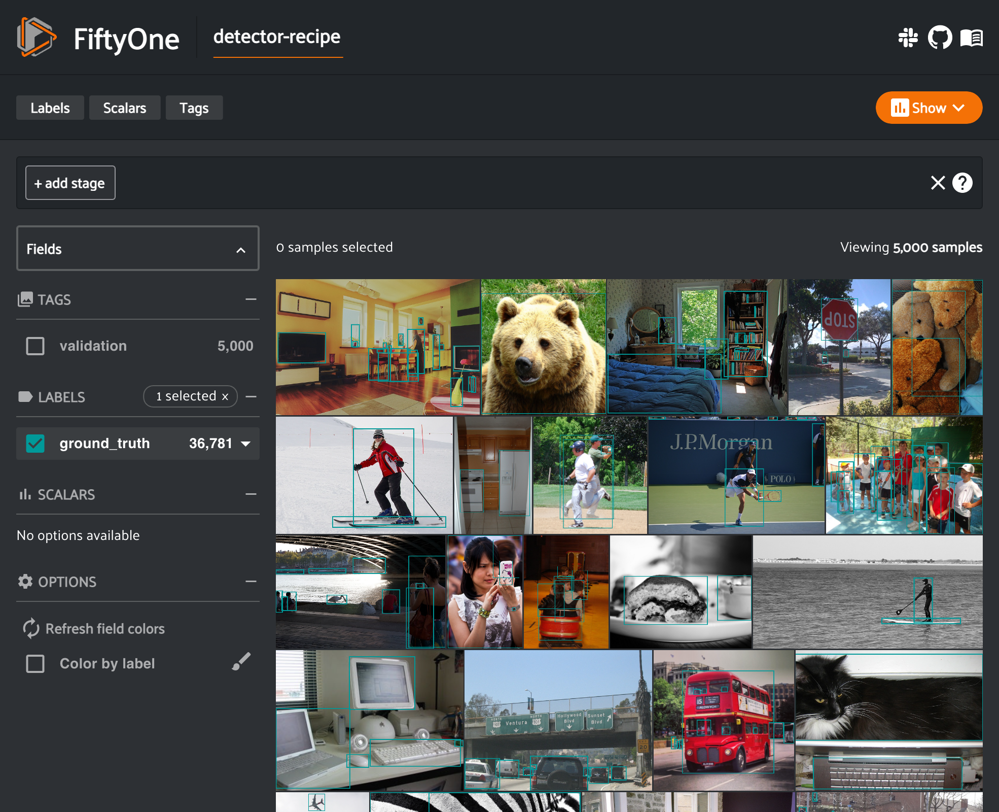

In [5]:
session = fo.launch_app(dataset)

## Adding model predictions

Now let's add some predictions from an object detector to the dataset.

We'll use an off-the-shelf [Faster R-CNN detection model](https://pytorch.org/docs/stable/torchvision/models.html#faster-r-cnn) provided by PyTorch. The following cell downloads the model and loads it:

In [1]:
import torch
import torchvision

# Run the model on GPU if it is available
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Load a pre-trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
model.to(device)
model.eval()

print("Model ready")

Model ready


The code below performs inference with the model on a randomly chosen subset of 100 samples from the dataset and [stores the predictions](https://voxel51.com/docs/fiftyone/user_guide/using_datasets.html#object-detection) in a `predictions` field of the samples. 

In [6]:
# Choose a random subset of 100 samples to add predictions to
predictions_view = dataset.take(100, seed=51)

In [7]:
from PIL import Image
from torchvision.transforms import functional as func

import fiftyone as fo

# Get class list
classes = dataset.default_classes

# Add predictions to samples
with fo.ProgressBar() as pb:
    for sample in pb(predictions_view):
        # Load image
        image = Image.open(sample.filepath)
        image = func.to_tensor(image).to(device)
        c, h, w = image.shape

        # Perform inference
        preds = model([image])[0]
        labels = preds["labels"].cpu().detach().numpy()
        scores = preds["scores"].cpu().detach().numpy()
        boxes = preds["boxes"].cpu().detach().numpy()

        # Convert detections to FiftyOne format
        detections = []
        for label, score, box in zip(labels, scores, boxes):
            # Convert to [top-left-x, top-left-y, width, height]
            # in relative coordinates in [0, 1] x [0, 1]
            x1, y1, x2, y2 = box
            rel_box = [x1 / w, y1 / h, (x2 - x1) / w, (y2 - y1) / h]

            detections.append(
                fo.Detection(
                    label=classes[label],
                    bounding_box=rel_box,
                    confidence=score
                )
            )

        # Save predictions to dataset
        sample["predictions"] = fo.Detections(detections=detections)
        sample.save()

 100% |██████████████████████| 100/100 [12.7m elapsed, 0s remaining, 0.1 samples/s]    


Let's load `predictions_view` in the App to visualize the predictions that we added:


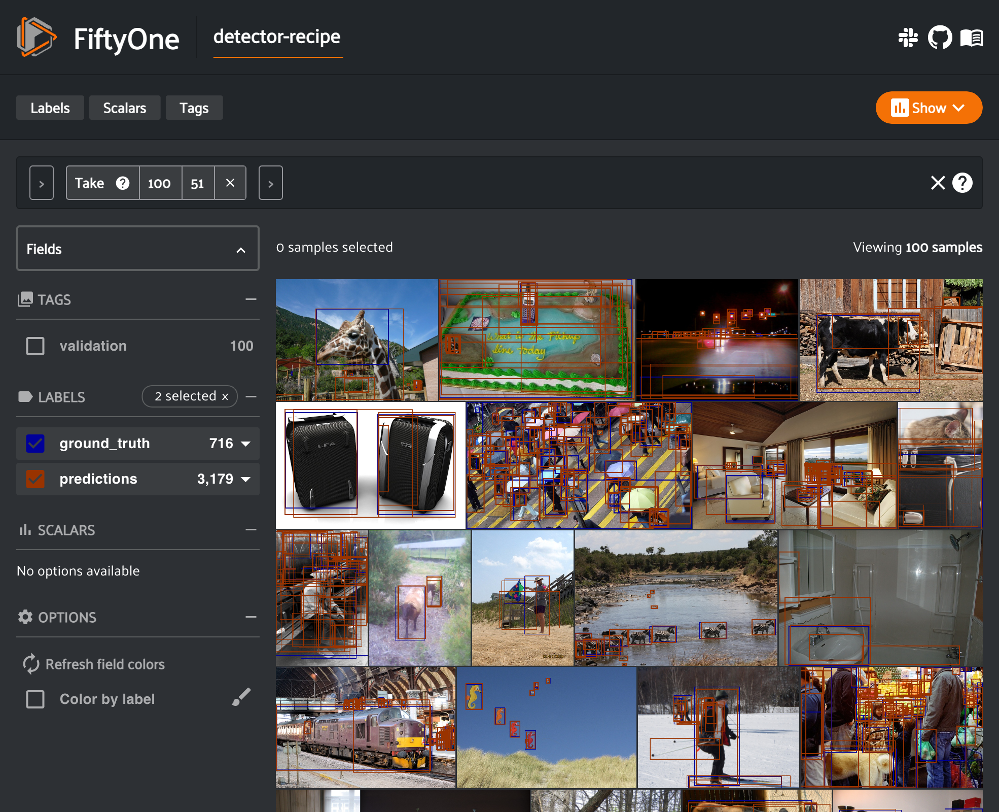

In [11]:
session.view = predictions_view

## Using the FiftyOne App

Now let's use the App to analyze the predictions we've added to our dataset in more detail.

### Visualizing bounding boxes

Each field of the samples are shown as togglable checkboxes on the left sidebar which can be used to control whether ground truth or predicted boxes are rendered on the images.

You can also double-click on an image to view individual samples in more detail:


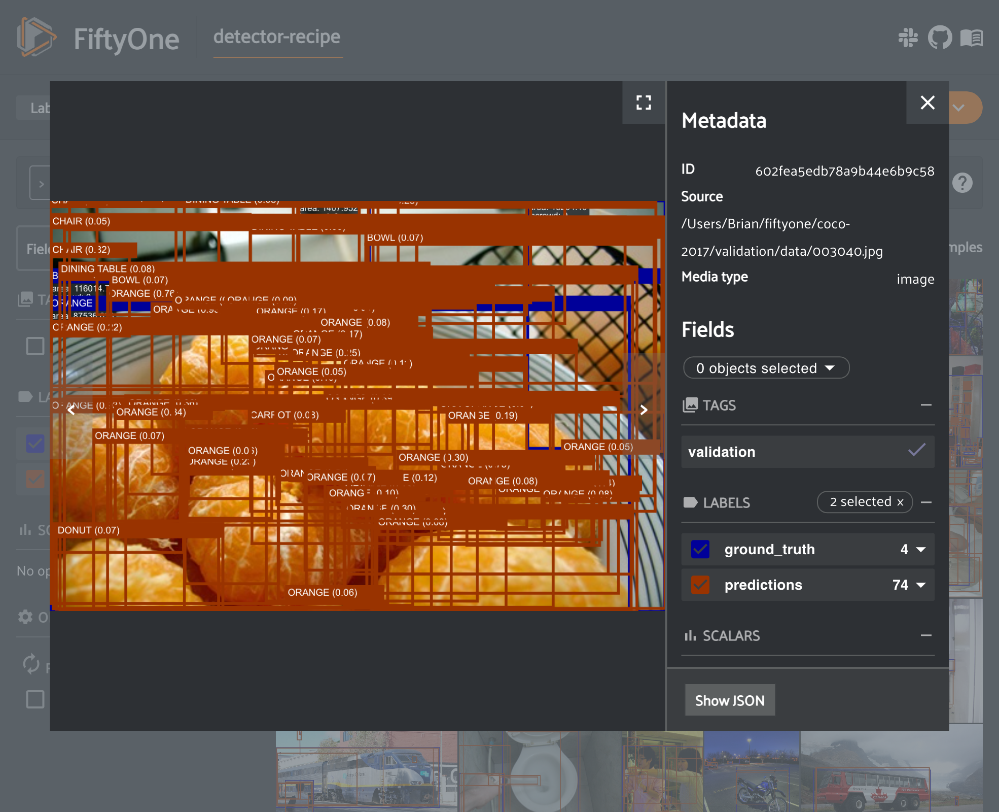

In [12]:
session.show()

### Visualizing object patches

It can be beneficial to view every object as an individual sample, especially when there are multiple overlapping detections like in the image above. 

In FiftyOne this is called a [patches view](https://voxel51.com/docs/fiftyone/user_guide/app.html#viewing-object-patches) and can be created through Python or directly in the App.

In [2]:
patches_view = predictions_view.to_patches("ground_truth")
print(patches_view)

Dataset:     detector-recipe
Media type:  image
Num patches: 849
Tags:        ['validation']
Patch fields:
    filepath:     fiftyone.core.fields.StringField
    tags:         fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.Metadata)
    sample_id:    fiftyone.core.fields.StringField
    ground_truth: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detection)
View stages:
    1. Exists(field='predictions', bool=True)
    2. ToPatches(field='ground_truth')


Let's use the App to create the same view as above. To do so, we just need to click the [patches button](https://voxel51.com/docs/fiftyone/user_guide/app.html#viewing-object-patches) in the App and select `ground_truth`.


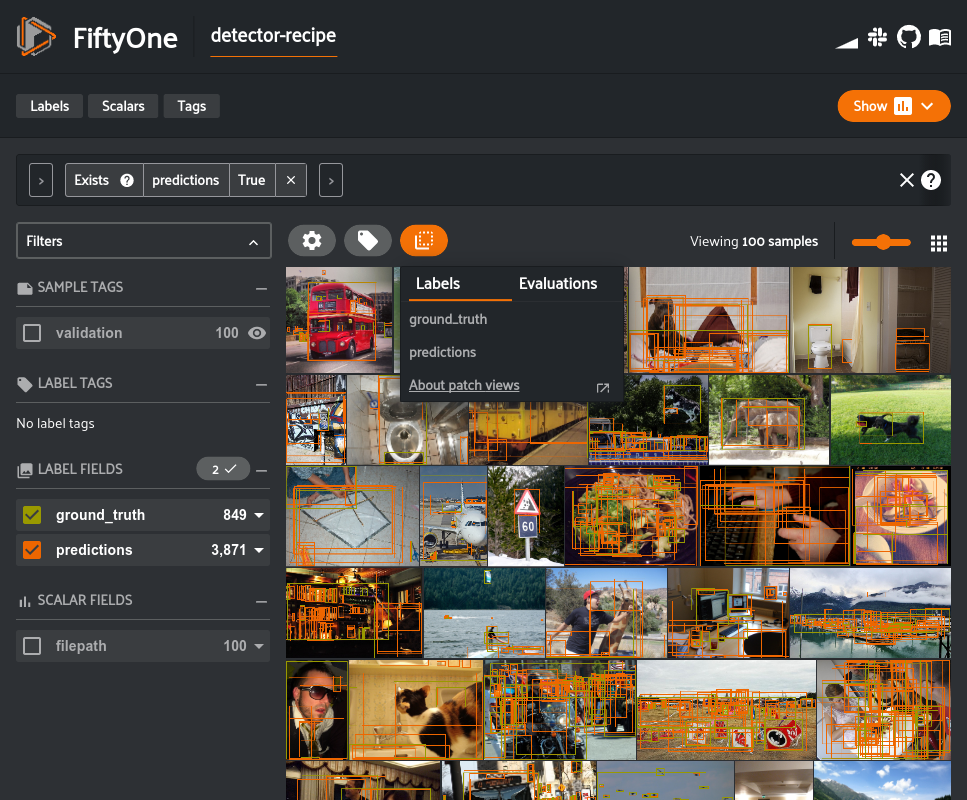

In [3]:
session = fo.launch_app(view=predictions_view)


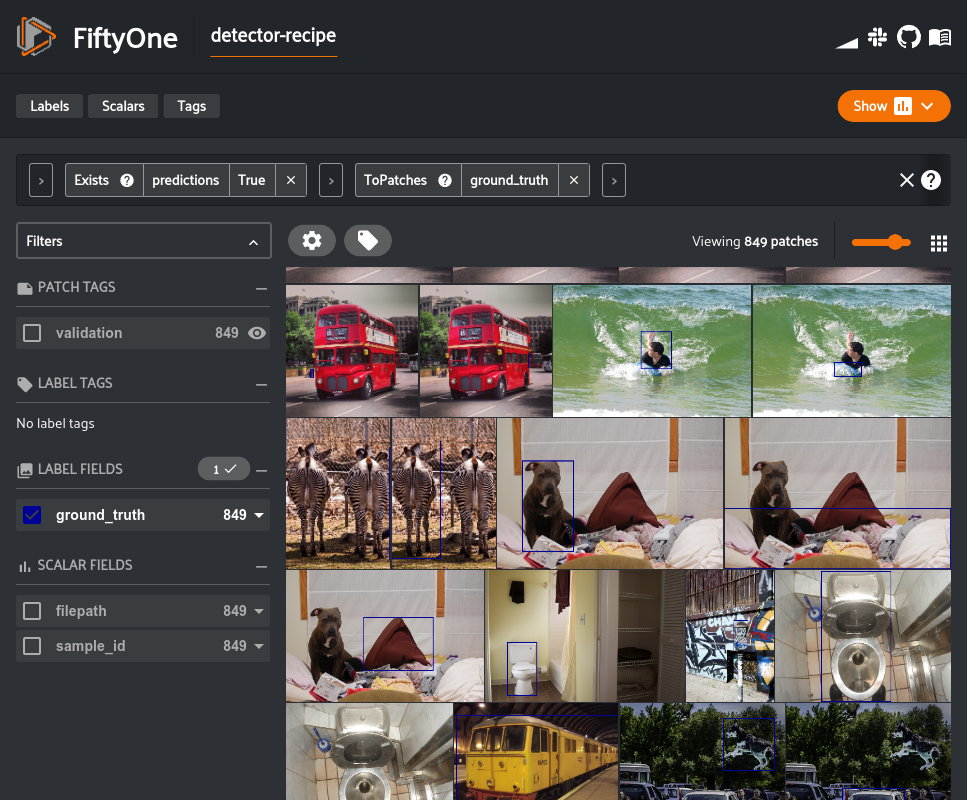

In [5]:
session = fo.launch_app(view=predictions_view)

### Confidence thresholding in the App

From the App instance above, it looks like our detector is generating some spurious low-quality detections. Let's use the App to interactively filter the predictions by `confidence` to identify a reasonable confidence threshold for our model:


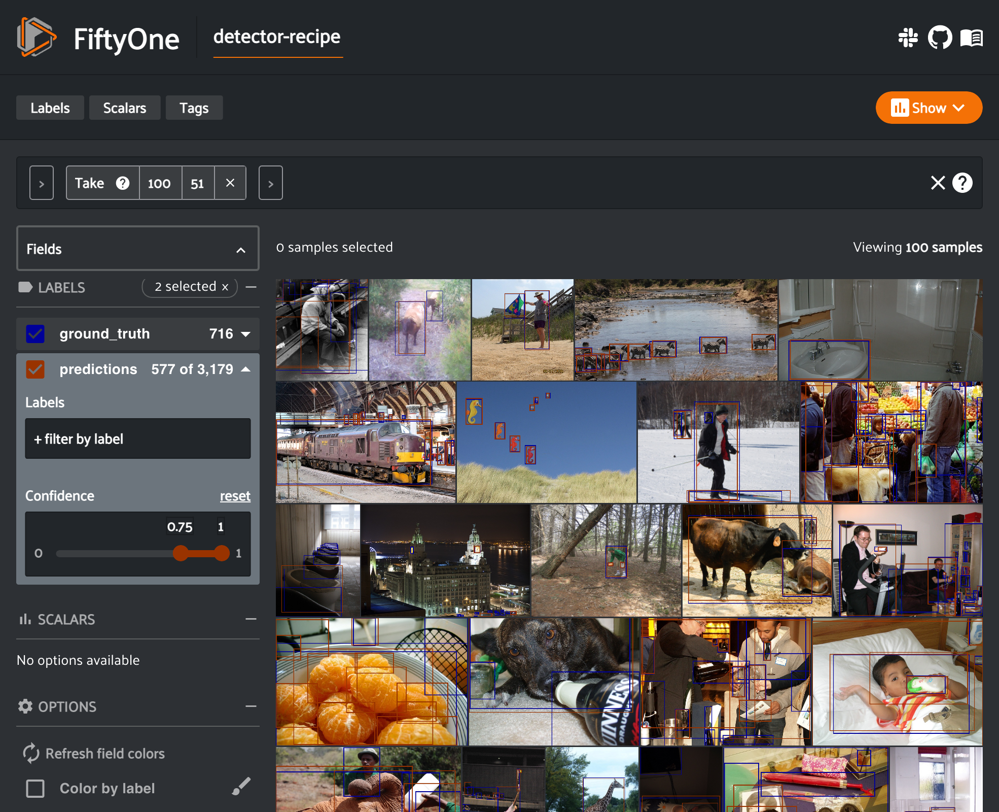

In [13]:
# Click the down caret on the `predictions` field of Fields Sidebar
# and apply a confidence threshold
session.show()

### Confidence thresholding in Python

FiftyOne also provides the ability to [write expressions](https://voxel51.com/docs/fiftyone/user_guide/using_views.html#filtering) that match, filter, and sort detections based on their attributes. See [using DatasetViews](https://voxel51.com/docs/fiftyone/user_guide/using_views.html) for full details.

For example, we can programmatically generate a view that contains only detections whose `confidence` is at least `0.75` as follows:

In [15]:
from fiftyone import ViewField as F

# Only contains detections with confidence >= 0.75
high_conf_view = predictions_view.filter_labels("predictions", F("confidence") > 0.75)

In [16]:
# Print some information about the view
print(high_conf_view)

Dataset:        detector-recipe
Media type:     image
Num samples:    100
Tags:           ['validation']
Sample fields:
    filepath:     fiftyone.core.fields.StringField
    tags:         fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.Metadata)
    ground_truth: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    predictions:  fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
View stages:
    1. Take(size=100, seed=51)
    2. FilterLabels(field='predictions', filter={'$gt': ['$$this.confidence', 0.75]}, only_matches=True)


In [18]:
# Print a prediction from the view to verify that its confidence is > 0.75
sample = high_conf_view.first()
print(sample.predictions.detections[0])

<Detection: {
    'id': '602feaf5db78a9b44e6c1423',
    'attributes': BaseDict({}),
    'label': 'giraffe',
    'bounding_box': BaseList([
        0.24742321968078612,
        0.24475666681925456,
        0.5395549297332763,
        0.742965825398763,
    ]),
    'mask': None,
    'confidence': 0.9984311461448669,
    'index': None,
}>


Now let's load our view in the App to view the predictions that we programmatically selected:


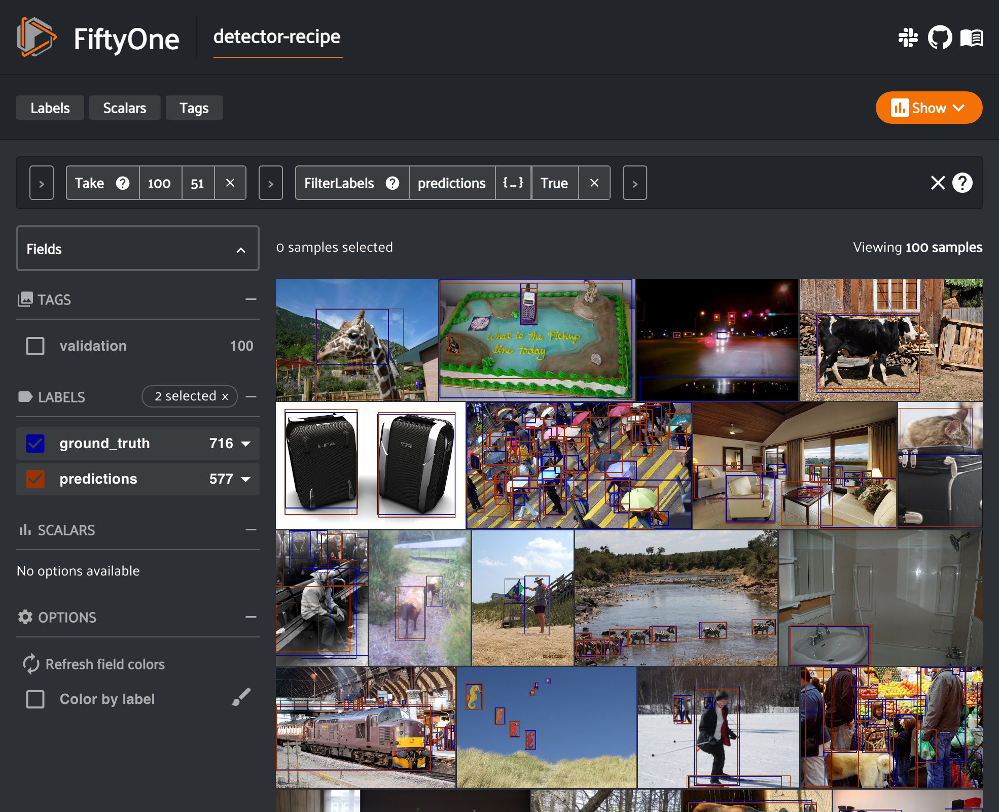

In [19]:
# Load high confidence view in the App
session.view = high_conf_view

### Selecting samples of interest

You can select images in the App by clicking on them. Then, you can create a view that contains only those samples by opening the selected samples dropdown in the top left corner of the image grid and clicking `Only show selected`.


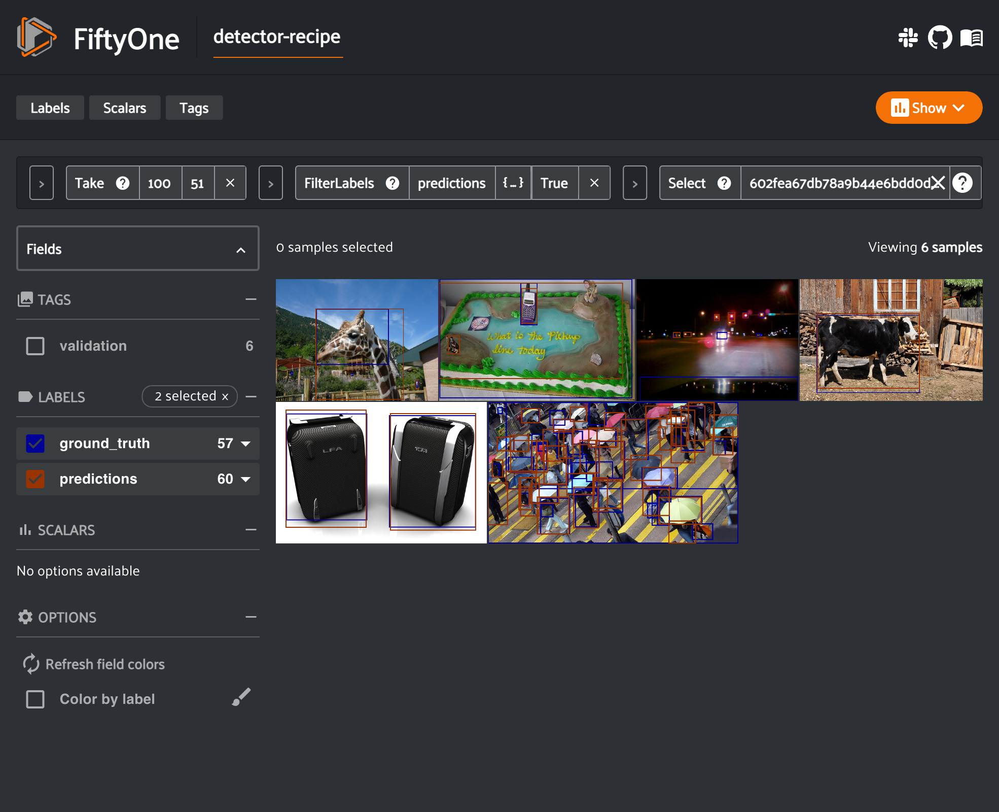

In [20]:
session.show()

In [21]:
session.freeze() # screenshot the active App for sharing